<a href="https://colab.research.google.com/github/KayvanShah1/folium-map-project/blob/main/city_zoning_notebooks/new_york.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Imports

In [36]:
!pip install gmaps
!pip install geopandas
!pip install --upgrade plotly
!pip install ipython-autotime
%load_ext autotime

Requirement already up-to-date: plotly in /usr/local/lib/python3.7/dist-packages (4.14.3)
The autotime extension is already loaded. To reload it, use:
  %reload_ext autotime
time: 11.9 s (started: 2021-04-29 09:29:40 +00:00)


In [37]:
import requests
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt

import gmaps
import gmaps.geojson_geometries
gmaps.configure(api_key='AIza...')

%matplotlib inline

time: 7.19 ms (started: 2021-04-29 09:29:52 +00:00)


# New york geojson

In [38]:
new_york = requests.get('https://services5.arcgis.com/GfwWNkhOj9bNBqoJ/arcgis/rest/services/nyzd/FeatureServer/0/query?where=1=1&outFields=*&outSR=4326&f=pgeojson').json()
new_york = pd.json_normalize(new_york['features'])
print(new_york.shape)
new_york.head()

(5245, 8)


,type,id,geometry.type,geometry.coordinates,properties.OBJECTID,properties.ZONEDIST,properties.Shape__Area,properties.Shape__Length
0,Feature,1,Polygon,"[[[-74.0075344655099, 40.6277304963165], [-74....",1,R4-1,372245.385620,2575.578630
1,Feature,2,Polygon,"[[[-73.9560353377992, 40.7092946241271], [-73....",2,PARK,16069.895142,569.651123
2,Feature,3,Polygon,"[[[-73.9860420082192, 40.6600898706832], [-73....",3,PARK,20178.003433,719.458367
3,Feature,4,Polygon,"[[[-73.9918730802955, 40.6769546285913], [-73....",4,M1-1,205524.826508,2499.135233
4,Feature,5,Polygon,"[[[-73.8955343370658, 40.6727599798171], [-73....",5,C4-4D,75618.341309,1147.584820


time: 5.16 s (started: 2021-04-29 09:29:52 +00:00)


In [39]:
new_york.sort_values('properties.ZONEDIST')['properties.ZONEDIST'].unique()

array(['BALL FIELD', 'BPC', 'C1-6', 'C1-6A', 'C1-7', 'C1-7A', 'C1-8',
       'C1-8A', 'C1-8X', 'C1-9', 'C1-9A', 'C2-6', 'C2-6A', 'C2-7',
       'C2-7A', 'C2-8', 'C2-8A', 'C3', 'C3A', 'C4-1', 'C4-2', 'C4-2A',
       'C4-2F', 'C4-3', 'C4-3A', 'C4-4', 'C4-4A', 'C4-4D', 'C4-4L',
       'C4-5', 'C4-5A', 'C4-5D', 'C4-5X', 'C4-6', 'C4-6A', 'C4-7', 'C5-1',
       'C5-1A', 'C5-2', 'C5-2.5', 'C5-2A', 'C5-3', 'C5-4', 'C5-5', 'C5-P',
       'C6-1', 'C6-1A', 'C6-1G', 'C6-2', 'C6-2A', 'C6-2G', 'C6-2M',
       'C6-3', 'C6-3A', 'C6-3D', 'C6-3X', 'C6-4', 'C6-4.5', 'C6-4A',
       'C6-4M', 'C6-4X', 'C6-5', 'C6-5.5', 'C6-6', 'C6-6.5', 'C6-7',
       'C6-7T', 'C6-9', 'C7', 'C8-1', 'C8-2', 'C8-3', 'C8-4', 'M1-1',
       'M1-1/R5', 'M1-1/R6A', 'M1-1/R7-2', 'M1-1/R7D', 'M1-1D', 'M1-2',
       'M1-2/R5B', 'M1-2/R5D', 'M1-2/R6', 'M1-2/R6A', 'M1-2/R6B',
       'M1-2/R7-1', 'M1-2/R7-2', 'M1-2/R7A', 'M1-2/R8', 'M1-2/R8A',
       'M1-2D', 'M1-3', 'M1-3/R7X', 'M1-3/R8', 'M1-4', 'M1-4/R6',
       'M1-4/R6A', 'M1-4/R

time: 15.3 ms (started: 2021-04-29 09:29:57 +00:00)


In [40]:
fav_zone = [
    'C1-6', 'C1-6A', 'C1-7', 'C1-7A', 'C1-8', 'C1-8A', 'C1-8X', 'C1-9', 'C1-9A', 'C2-6', 'C2-6A', 'C2-7',
    'C2-7A', 'C2-8', 'C2-8A', 'C3', 'C3A', 'C4-1', 'C4-2', 'C4-2A', 'C4-2F', 'C4-3', 'C4-3A', 'C4-4', 'C4-4A', 'C4-4D', 'C4-4L',
    'C4-5', 'C4-5A', 'C4-5D', 'C4-5X', 'C4-6', 'C4-6A', 'C4-7', 'C5-1', 'C5-1A', 'C5-2', 'C5-2.5', 'C5-2A', 'C5-3', 'C5-4', 'C5-5', 'C5-P',
    'C6-1', 'C6-1A', 'C6-1G', 'C6-2', 'C6-2A', 'C6-2G', 'C6-2M', 'C6-3', 'C6-3A', 'C6-3D', 'C6-3X', 'C6-4', 'C6-4.5', 'C6-4A',
    'C6-4M', 'C6-4X', 'C6-5', 'C6-5.5', 'C6-6', 'C6-6.5', 'C6-7', 'C6-7T', 'C6-9', 'C7', 'C8-1', 'C8-2', 'C8-3', 'C8-4', 'M1-1',
    'M1-1/R5', 'M1-1/R6A', 'M1-1/R7-2', 'M1-1/R7D', 'M1-1D', 'M1-2', 'M1-2/R5B', 'M1-2/R5D', 'M1-2/R6', 'M1-2/R6A', 'M1-2/R6B',
    'M1-2/R7-1', 'M1-2/R7-2', 'M1-2/R7A', 'M1-2/R8', 'M1-2/R8A', 'M1-2D', 'M1-3', 'M1-3/R7X', 'M1-3/R8', 'M1-4', 'M1-4/R6',
    'M1-4/R6A', 'M1-4/R6B', 'M1-4/R7-2', 'M1-4/R7A', 'M1-4/R7D', 'M1-4/R7X', 'M1-4/R8A', 'M1-4/R9A', 'M1-4D', 'M1-5', 'M1-5/R10',
    'M1-5/R7-2', 'M1-5/R7-3', 'M1-5/R7X', 'M1-5/R8A', 'M1-5/R9', 'M1-5/R9-1', 'M1-5A', 'M1-5B', 'M1-5M', 'M1-6', 'M1-6/R10',
    'M1-6/R8X', 'M1-6/R9', 'M1-6D', 'M2-1', 'M2-2', 'M2-3', 'M2-4','M3-1', 'M3-2'
]
commercial = [
    'C1-6', 'C1-6A', 'C1-7', 'C1-7A', 'C1-8', 'C1-8A', 'C1-8X', 'C1-9', 'C1-9A', 'C2-6', 'C2-6A', 'C2-7',
    'C2-7A', 'C2-8', 'C2-8A', 'C3', 'C3A', 'C4-1', 'C4-2', 'C4-2A', 'C4-2F', 'C4-3', 'C4-3A', 'C4-4', 'C4-4A', 'C4-4D', 'C4-4L',
    'C4-5', 'C4-5A', 'C4-5D', 'C4-5X', 'C4-6', 'C4-6A', 'C4-7', 'C5-1', 'C5-1A', 'C5-2', 'C5-2.5', 'C5-2A', 'C5-3', 'C5-4', 'C5-5', 'C5-P',
    'C6-1', 'C6-1A', 'C6-1G', 'C6-2', 'C6-2A', 'C6-2G', 'C6-2M', 'C6-3', 'C6-3A', 'C6-3D', 'C6-3X', 'C6-4', 'C6-4.5', 'C6-4A',
    'C6-4M', 'C6-4X', 'C6-5', 'C6-5.5', 'C6-6', 'C6-6.5', 'C6-7', 'C6-7T', 'C6-9', 'C7', 'C8-1', 'C8-2', 'C8-3', 'C8-4'
]
manufracturing_zones = [
    'M1-1D', 'M1-2', 'M1-2D', 'M1-3', 'M1-4',
    'M1-4D', 'M1-5', 'M1-5A', 'M1-5B', 'M1-5M', 'M1-6',
    'M1-6D', 'M2-1', 'M2-2', 'M2-3', 'M2-4','M3-1', 'M3-2','M1-1'
]
manufracturing_residential_zones = [
    'M1-1/R5', 'M1-1/R6A', 'M1-1/R7-2', 'M1-1/R7D', 'M1-2/R5B', 'M1-2/R5D', 'M1-2/R6', 'M1-2/R6A', 'M1-2/R6B',
    'M1-2/R7-1', 'M1-2/R7-2', 'M1-2/R7A', 'M1-2/R8', 'M1-2/R8A', 'M1-3/R7X', 'M1-3/R8', 'M1-4/R6',
    'M1-4/R6A', 'M1-4/R6B', 'M1-4/R7-2', 'M1-4/R7A', 'M1-4/R7D', 'M1-4/R7X', 'M1-4/R8A', 'M1-4/R9A','M1-5/R10',
    'M1-5/R7-2', 'M1-5/R7-3', 'M1-5/R7X', 'M1-5/R8A', 'M1-5/R9', 'M1-5/R9-1', 'M1-6/R10', 'M1-6/R8X', 'M1-6/R9'
]
residentail_zones = [
    'R1-2', 'R1-2A', 'R10', 'R10A', 'R10H', 'R2', 'R2A', 'R2X', 'R3-1',
    'R3-2', 'R3A', 'R3X', 'R4', 'R4-1', 'R4A', 'R4B', 'R5', 'R5A',
    'R5B', 'R5D', 'R6', 'R6A', 'R6B', 'R7-1', 'R7-2', 'R7-3', 'R7A',
    'R7B', 'R7D', 'R7X', 'R8', 'R8A', 'R8B', 'R8X', 'R9', 'R9-1',
    'R9A', 'R9X', 'R1-1'
]
parks_playgrounds = [
    'BALL FIELD', 'BPC', 'PARK', 'PLAYGROUND', 'PUBLIC PLACE'
]

time: 28.7 ms (started: 2021-04-29 09:29:57 +00:00)


In [41]:
nyc = gpd.read_file('https://services5.arcgis.com/GfwWNkhOj9bNBqoJ/arcgis/rest/services/nyzd/FeatureServer/0/query?where=1=1&outFields=*&outSR=4326&f=pgeojson')
# nyc = nyc[nyc['ZONEDIST'].isin(fav_zone)]
nyc.to_file("NYC_INDUSTRIAL_COMMERCIAL_ZONE.json", driver="GeoJSON")
print(nyc.shape)
nyc.head()

(5245, 5)


,OBJECTID,ZONEDIST,Shape__Area,Shape__Length,geometry
0,1,R4-1,372245.385620,2575.578630,"POLYGON ((-74.00753 40.62773, -74.00870 40.626..."
1,2,PARK,16069.895142,569.651123,"POLYGON ((-73.95604 40.70929, -73.95635 40.708..."
2,3,PARK,20178.003433,719.458367,"POLYGON ((-73.98604 40.66009, -73.98627 40.659..."
3,4,M1-1,205524.826508,2499.135233,"POLYGON ((-73.99187 40.67695, -73.99188 40.676..."
4,5,C4-4D,75618.341309,1147.584820,"POLYGON ((-73.89553 40.67276, -73.89550 40.672..."


time: 6.5 s (started: 2021-04-29 09:29:57 +00:00)


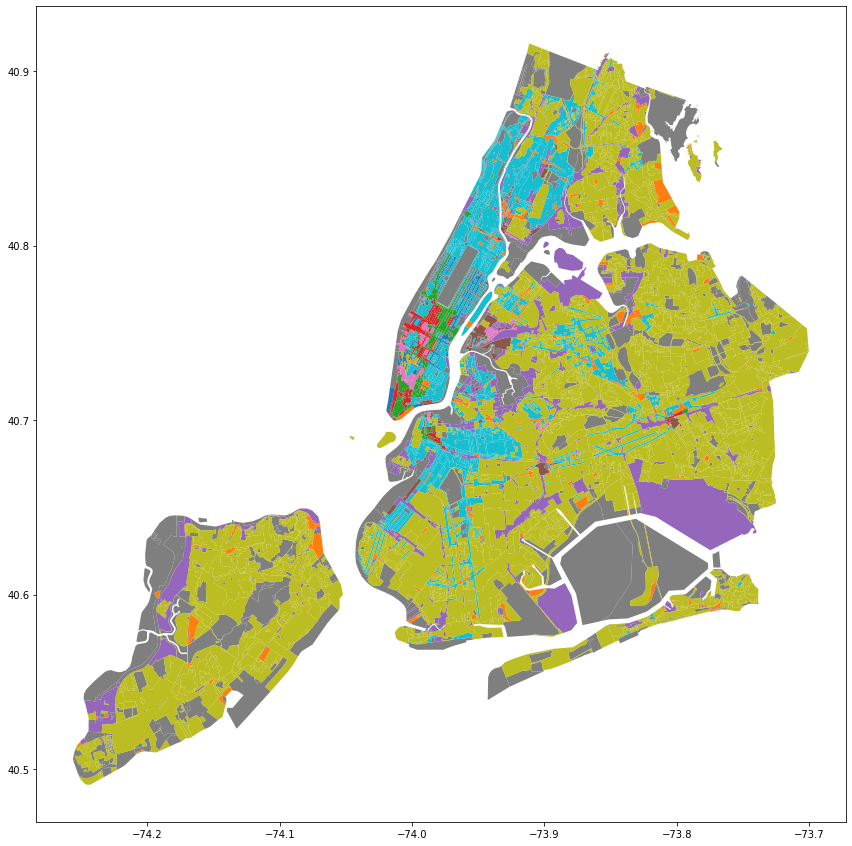

time: 1.89 s (started: 2021-04-29 09:30:04 +00:00)


In [42]:
nyc.plot(column='ZONEDIST',figsize=(15,15))

# Power Plants db

In [77]:
from math import cos, asin, sqrt, pi
def distance(lat1, lon1, lat2, lon2):
    p = pi/180
    a = 0.5 - cos((lat2-lat1)*p)/2 + cos(lat1*p) * cos(lat2*p) * (1-cos((lon2-lon1)*p))/2
    return 12742 * asin(sqrt(a))

psd = pd.read_csv('/content/global_power_plant_database.csv')
latlon = psd[['latitude','longitude']].values.tolist()
distance = [distance(40.7125,-73.933,i[0],i[1]) for i in latlon]
psd['distance_from_city_in_km'] = distance
psd.drop(
    columns=[
        'url','geolocation_source','wepp_id',
        'generation_gwh_2013','generation_gwh_2014','generation_gwh_2015','generation_gwh_2016','generation_gwh_2017',
    ],
    inplace=True
)
psd = psd[psd['country'].isin(['USA'])].sort_values('distance_from_city_in_km')
psd = psd[psd['distance_from_city_in_km']<100]
print(psd.shape)
psd.tail()

(312, 17)


,country,country_long,name,gppd_idnr,capacity_mw,latitude,longitude,primary_fuel,other_fuel1,other_fuel2,other_fuel3,commissioning_year,owner,source,year_of_capacity_data,estimated_generation_gwh,distance_from_city_in_km
29030,USA,United States of America,Warren County Solar,USA0056888,2.0,40.7890,-75.1070,Solar,NaN,NaN,NaN,2012.0,EPP Renewable Energy,U.S. Energy Information Administration,2017.0,NaN,99.257983
25331,USA,United States of America,Lower Mount Bethel Energy,USA0055667,651.6,40.8019,-75.1076,Gas,NaN,NaN,NaN,2004.0,Lower Mount Bethel Energy LLC,U.S. Energy Information Administration,2017.0,NaN,99.431916
23480,USA,United States of America,Florence Solar W3-080 LLC,USA0060990,7.9,40.0956,-74.7876,Solar,NaN,NaN,NaN,2017.0,Florence Solar W3-080 LLC,U.S. Energy Information Administration,2017.0,3.522829,99.707372
24660,USA,United States of America,JMB Mcguire-Dix-Lakehurst Solar Project,USA0058793,11.4,39.9928,-74.6369,Solar,NaN,NaN,NaN,2013.0,WR-TGC Solar Generation IV LLC,U.S. Energy Information Administration,2017.0,NaN,99.809753
24344,USA,United States of America,Holland Solar,USA0060763,3.0,40.5997,-75.1086,Solar,NaN,NaN,NaN,2016.0,Marina Energy LLC,U.S. Energy Information Administration,2017.0,1.337783,99.958444


time: 413 ms (started: 2021-04-29 10:41:53 +00:00)


# Folium Maps

In [95]:
#@title ###Jquery Draggable Legend { form-width: "15%" }
from branca.element import Template, MacroElement

template = """
{% macro html(this, kwargs) %}

<!doctype html>
<html lang="en">
<head>
  <meta charset="utf-8">
  <meta name="viewport" content="width=device-width, initial-scale=1">
  <title>New York City Zones</title>
  <link rel="stylesheet" href="//code.jquery.com/ui/1.12.1/themes/base/jquery-ui.css">

  <script src="https://code.jquery.com/jquery-1.12.4.js"></script>
  <script src="https://code.jquery.com/ui/1.12.1/jquery-ui.js"></script>
  
  <script>
  $( function() {
    $( "#maplegend" ).draggable({
                    start: function (event, ui) {
                        $(this).css({
                            right: "auto",
                            top: "auto",
                            bottom: "auto"
                        });
                    }
                });
});

  </script>
</head>
<body>
<div id='maplegend' class='maplegend' 
    style='position: absolute; z-index:9999; border:2px solid grey; background-color:rgba(255, 255, 255, 0.8);
     border-radius:6px; padding: 10px; font-size:14px; right: 20px; bottom: 20px;'>
     
<div class='legend-title'>Zones</div>
<div class='legend-scale'>
  <ul class='legend-labels'>
    <li><span style='background:red;opacity:0.5;'></span>Commercial</li>
    <li><span style='background:violet;opacity:0.5;'></span>Only Manufracturing</li>
    <li><span style='background:yellow;opacity:0.5;'></span>Only Residential</li>
    <li><span style='background:cyan;opacity:0.5;'></span>Both Manufracturing & Residential</li>
    <li><span style='background:green;opacity:0.5;'></span>Parks & Playgrounds</li>

  </ul>
</div>
</div>
 
</body>
</html>

<style type='text/css'>
  .maplegend .legend-title {
    text-align: left;
    margin-bottom: 5px;
    font-weight: bold;
    font-size: 90%;
    }
  .maplegend .legend-scale ul {
    margin: 0;
    margin-bottom: 5px;
    padding: 0;
    float: left;
    list-style: none;
    }
  .maplegend .legend-scale ul li {
    font-size: 80%;
    list-style: none;
    margin-left: 0;
    line-height: 18px;
    margin-bottom: 2px;
    }
  .maplegend ul.legend-labels li span {
    display: block;
    float: left;
    height: 16px;
    width: 30px;
    margin-right: 5px;
    margin-left: 0;
    border: 1px solid #999;
    }
  .maplegend .legend-source {
    font-size: 80%;
    color: #777;
    clear: both;
    }
  .maplegend a {
    color: #777;
    }
</style>
{% endmacro %}"""

time: 20.7 ms (started: 2021-04-29 11:08:29 +00:00)


In [47]:
#@title ###Without Power Plants Data { form-width: "15%" }
import folium
from folium import GeoJson
from folium import GeoJsonTooltip
# import branca.colormap as cm

def ColorCoder(x):
    if x['properties']['ZONEDIST'] in commercial:
        return {'fillColor': 'red', 'lineColor':'red', 'color': 'red', 'weight': 0.5}
    elif x['properties']['ZONEDIST'] in manufracturing_zones:
        return {'fillColor': 'violet', 'lineColor':'violet', 'color': 'violet', 'weight': 0.5}
    elif x['properties']['ZONEDIST'] in manufracturing_residential_zones:
        return {'fillColor': 'cyan', 'lineColor':'cyan', 'color': 'cyan', 'weight': 0.5}
    elif x['properties']['ZONEDIST'] in residentail_zones:
        return {'fillColor': 'yellow', 'lineColor':'yellow', 'color': 'yellow', 'weight': 0.5}
    elif x['properties']['ZONEDIST'] in parks_playgrounds:
        return {'fillColor': 'green', 'lineColor':'green', 'color': 'green', 'weight': 0.5}

highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}

m=folium.Map(
    location=[40.7125, -73.933],
    zoom_start=10,
)
GeoJson(
    nyc,
    style_function = ColorCoder,
    highlight_function=highlight_function,
    tooltip = GeoJsonTooltip(['ZONEDIST'])
).add_to(m)
 
folium.TileLayer('cartodbdark_matter',name="Dark mode",control=True).add_to(m)
folium.TileLayer('cartodbpositron',name="Light mode",control=True).add_to(m)
folium.LayerControl(collapsed=True).add_to(m)

macro = MacroElement()
macro._template = Template(template)
m.get_root().add_child(macro)
m

time: 7.18 s (started: 2021-04-29 09:31:25 +00:00)


In [48]:
m.save('new_york_zones.html')

time: 2.55 s (started: 2021-04-29 09:38:02 +00:00)


In [107]:
psd.columns

Index(['country', 'country_long', 'name', 'gppd_idnr', 'capacity_mw',
       'latitude', 'longitude', 'primary_fuel', 'other_fuel1', 'other_fuel2',
       'other_fuel3', 'commissioning_year', 'owner', 'source',
       'year_of_capacity_data', 'estimated_generation_gwh',
       'distance_from_city_in_km'],
      dtype='object')

time: 6.71 ms (started: 2021-04-29 11:38:15 +00:00)


In [109]:
#@title ### With Power Plant Markers { form-width: "15%" }
import folium
from folium import GeoJson
from folium import GeoJsonTooltip
from folium.plugins import MarkerCluster
# import branca.colormap as cm

def ColorCoder(x):
    if x['properties']['ZONEDIST'] in commercial:
        return {'fillColor': 'red', 'lineColor':'red', 'color': 'red', 'weight': 0.5}
    elif x['properties']['ZONEDIST'] in manufracturing_zones:
        return {'fillColor': 'violet', 'lineColor':'violet', 'color': 'violet', 'weight': 0.5}
    elif x['properties']['ZONEDIST'] in manufracturing_residential_zones:
        return {'fillColor': 'cyan', 'lineColor':'cyan', 'color': 'cyan', 'weight': 0.5}
    elif x['properties']['ZONEDIST'] in residentail_zones:
        return {'fillColor': 'yellow', 'lineColor':'yellow', 'color': 'yellow', 'weight': 0.5}
    elif x['properties']['ZONEDIST'] in parks_playgrounds:
        return {'fillColor': 'green', 'lineColor':'green', 'color': 'green', 'weight': 0.5}

highlight_function = lambda x: {'fillColor': '#000000', 'color':'#000000', 'fillOpacity': 0.50, 'weight': 0.1}

m=folium.Map(
    location=[40.7125, -73.933],
    zoom_start=10,
)
GeoJson(
    nyc,
    style_function = ColorCoder,
    highlight_function=highlight_function,
    tooltip = GeoJsonTooltip(['ZONEDIST'],aliases=['Zone code:'])
).add_to(m)
 
locationlist = psd[['latitude','longitude']].values.tolist()
marker_cluster = MarkerCluster().add_to(m)
for point in range(0, len(locationlist)):
    popup_template = f"""
    <div>
        <strong>{psd['name'].tolist()[point]}</strong>
        <hr class='solid' style='border-width: 1.5px; border-color: black;'>
    </div>
    <div class="column">
    <table>
        <tr>
            <td><strong>Primary Fuel<strong></td>
            <td>{psd['primary_fuel'].tolist()[point]}</td>
        </tr>
        <tr>
            <td><strong>Capacity(in MW)<strong></td>
            <td>{psd['capacity_mw'].tolist()[point]}</td>
        </tr>
        <tr>
            <td><strong>Owner<strong></td>
            <td>{psd['owner'].tolist()[point]}</td>
        </tr>
        <tr>
            <td><strong>Distance(in KM)<strong><br><style='font-'>(from the center of the city)</style></td>
            <td>{round(psd['distance_from_city_in_km'].tolist()[point],2)}</td>
        </tr>
    </table>
    </div>
    """
    folium.Marker(
        locationlist[point], 
        tooltip='<strong>Power Plant: </strong>'+ psd['name'].tolist()[point],
        popup = folium.Popup(popup_template,max_width=500)
    ).add_to(marker_cluster)

folium.TileLayer('cartodbdark_matter',name="Dark mode",control=True).add_to(m)
folium.TileLayer('cartodbpositron',name="Light mode",control=True).add_to(m)
folium.LayerControl(collapsed=True).add_to(m)

macro = MacroElement()
macro._template = Template(template)
m.get_root().add_child(macro)
m

time: 7.92 s (started: 2021-04-29 11:43:12 +00:00)


In [110]:
round(465.98098,2)

465.98

time: 5.12 ms (started: 2021-04-29 11:50:41 +00:00)
